In [44]:
import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import pymc as pm
import seaborn as sns

plt.style.use("bmh")
plt.rcParams["figure.figsize"] = [12, 6]
plt.rcParams["figure.dpi"] = 100
plt.rcParams["figure.facecolor"] = "white"

%load_ext rich
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = "svg"

The rich extension is already loaded. To reload it, use:
  %reload_ext rich
The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [45]:
import pandas as pd
import statsmodels.api as sm

from bayesian import load_and_transform_company_data

dir = "data/"
df = load_and_transform_company_data(dir+"data4columbia_credit.csv")
df

,company,date,data,t
0,ef1bcca724f3,2016-01-01,266648.924500,0.000000
1,ef1bcca724f3,2016-01-02,330109.961300,0.000399
2,ef1bcca724f3,2016-01-03,248299.827200,0.000798
3,ef1bcca724f3,2016-01-04,146428.339600,0.001198
4,ef1bcca724f3,2016-01-05,146854.815500,0.001597
...,...,...,...,...
116654,e2415cb7f63d,2022-11-05,1149.371612,0.998004
116655,e2415cb7f63d,2022-11-06,890.458833,0.998403
116656,e2415cb7f63d,2022-11-07,1233.454763,0.998802
116657,e2415cb7f63d,2022-11-08,2478.464933,0.999202


## Generate Priors from Pooled Model

In [46]:
#First, min-max transform all company data
norm_data = []
train_test_date = datetime.datetime(2021,1,1)
df.date = pd.to_datetime(df.date)
df = df[df.date < train_test_date]

for c in df.company.unique():
    zdf = df[df.company==c]
    # zdf.data = (zdf.data - zdf.data.min())/(zdf.data.max()-zdf.data.min())
    norm_data.append(zdf)
    
zdf = pd.concat(norm_data)
zdf = zdf.set_index('date')

m =BayesianModel(model_type='pooled',train_data=zdf,test_data=zdf)
m.setup_model()
m.sample_prior()
data = m.sample_posterior()
az.summary(data=data)

Sampling: [lag_coefs, likelihood, α, β, β_fourier_yr, σ]
Only 100 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [α, β, σ, lag_coefs, β_fourier_yr]


Sampling 4 chains for 1_000 tune and 100 draw iterations (4_000 + 400 draws total) took 2398 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [likelihood]


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
α,1432.542,88.415,1251.018,1585.353,4.590,3.248,366.0,341.0,1.01
β,0.073,0.918,-1.659,1.899,0.031,0.050,887.0,264.0,1.01
lag_coefs,0.963,0.001,0.961,0.965,0.000,0.000,361.0,278.0,1.01
β_fourier_yr[0],0.282,9.944,-17.598,17.371,0.388,0.661,674.0,188.0,1.05
β_fourier_yr[1],-0.377,9.944,-20.321,16.959,0.308,0.570,1041.0,285.0,1.02
...,...,...,...,...,...,...,...,...,...
trend[84078],1432.595,88.418,1251.215,1585.263,4.589,3.247,366.0,313.0,1.01
trend[84079],1432.595,88.418,1251.216,1585.263,4.589,3.247,366.0,313.0,1.01
trend[84080],1432.595,88.418,1251.216,1585.263,4.589,3.247,366.0,313.0,1.01
trend[84081],1432.595,88.418,1251.216,1585.262,4.589,3.247,366.0,313.0,1.01


## Use Pooled Priors in Hierarchical Model

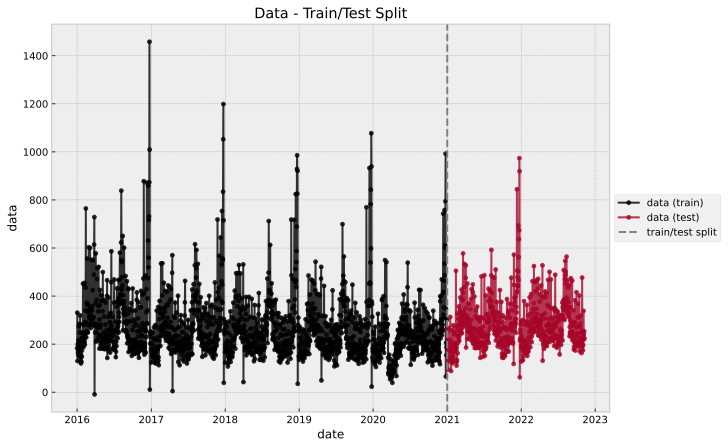

In [53]:
import datetime
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (10,7)
from bayesian import run_decompose
from bayesian import load_and_transform_company_data

dir = "data/"
df = load_and_transform_company_data(dir+"data4columbia_credit.csv",min_max_data=False)
train_test_date = datetime.datetime(2021,1,1)
df_train, df_test = run_decompose(df, 1, train_test_date)

#Plot train test split
fig, ax = plt.subplots()
sns.lineplot(
    x="date",
    y="data",
    data=df_train,
    marker="o",
    color="black",
    alpha=0.8,
    markersize=4,
    markeredgecolor="black",
    label="data (train)",
    ax=ax,
)
sns.lineplot(
    x="date",
    y="data",
    data=df_test,
    marker="o",
    color="C1",
    alpha=0.8,
    markersize=4,
    markeredgecolor="C1",
    label="data (test)",
    ax=ax,
)
ax.axvline(x=train_test_date, color="gray", linestyle="--", label="train/test split")
ax.legend(loc="center left", bbox_to_anchor=(1, 0.5))
ax.set(title="Data - Train/Test Split");

/tmp/ipykernel_591210/1051193171.py:2: DeprecationWarning: Please use `shift` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  from scipy.ndimage.interpolation import shift
Sampling: [lag_coefs, likelihood, α, β, β_fourier_yr, σ]


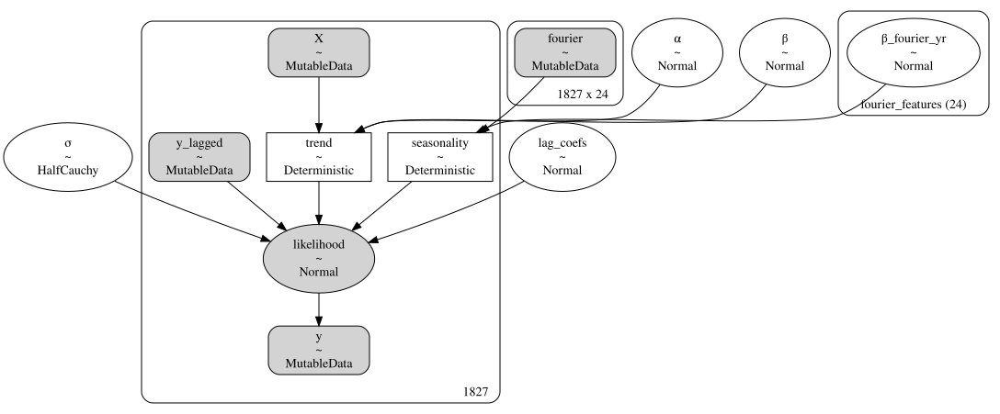

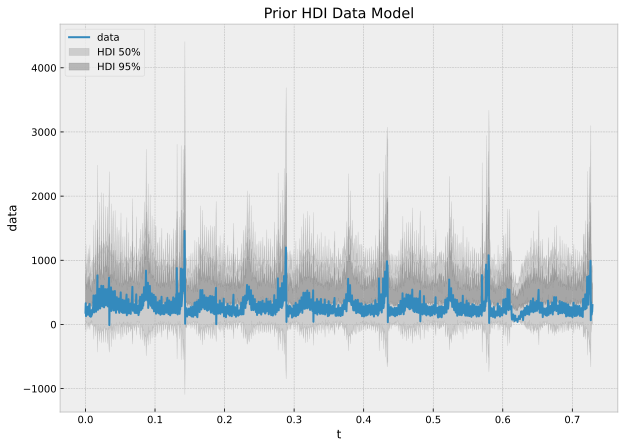

In [62]:
import numpy as np
from scipy.ndimage.interpolation import shift
from bayesian import BayesianModel


m =BayesianModel(model_type='unpooled',train_data=df_train,test_data=df_test,prior_beta_mean=0.073,prior_lag=0.963)
m.setup_model()
m.sample_prior()

pm.model_to_graphviz(m.model)

In [63]:
data = m.sample_posterior()
az.summary(data=data)



Only 100 samples in chain.
Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [α, β, σ, lag_coefs, β_fourier_yr]


Sampling 4 chains for 1_000 tune and 100 draw iterations (4_000 + 400 draws total) took 44 seconds.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details
Sampling: [likelihood]


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
α,160.268,6.376,148.068,171.183,0.333,0.236,369.0,338.0,1.00
β,-0.430,1.048,-2.447,1.482,0.032,0.051,1041.0,294.0,1.03
lag_coefs,0.401,0.023,0.358,0.438,0.001,0.001,377.0,363.0,1.00
β_fourier_yr[0],-4.194,3.522,-10.710,1.549,0.109,0.105,1041.0,261.0,1.00
β_fourier_yr[1],7.776,3.579,1.503,14.491,0.111,0.091,1041.0,221.0,1.00
...,...,...,...,...,...,...,...,...,...
trend[1822],159.955,6.399,148.052,171.528,0.331,0.234,377.0,371.0,1.00
trend[1823],159.955,6.399,148.053,171.528,0.331,0.234,377.0,371.0,1.00
trend[1824],159.955,6.399,148.053,171.527,0.331,0.234,377.0,371.0,1.00
trend[1825],159.955,6.399,148.054,171.527,0.331,0.234,377.0,371.0,1.00


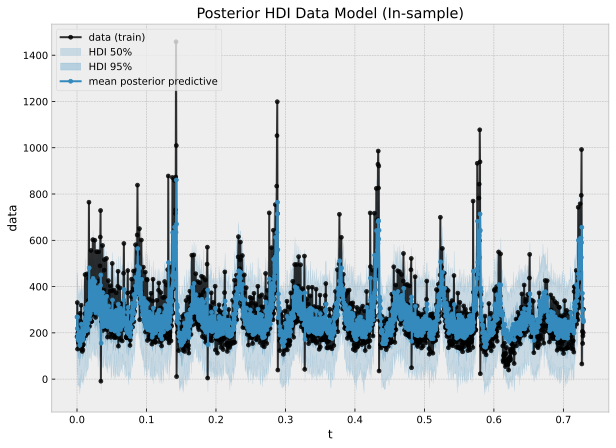

In [64]:
m.plot_trace()
m.plot_posterior_insample_fit()

Sampling: [likelihood]


7116.314265186697

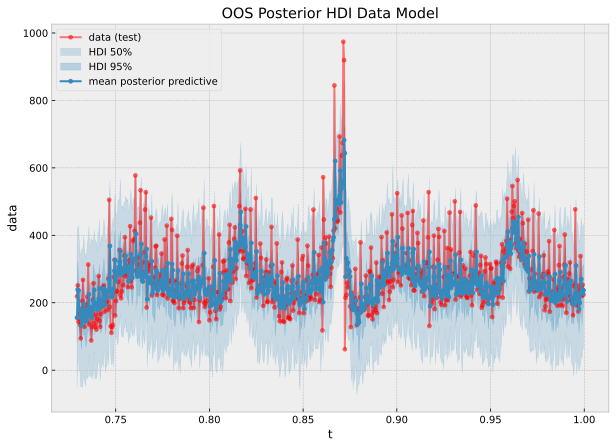

In [65]:
m.sample_test_data()
res_true, res_pred = m.plot_test_result()

from sklearn.metrics import mean_squared_error
mean_squared_error(res_true,res_pred)